In [4]:
library(tidyverse)
library(repr)
library(tidymodels)
library(readxl)
options(repr.matrix.max.rows = 6)

In [5]:
diabetes_data <- read_csv("data/diabetes.csv")

var1 = "bmi"
var2 = "blood_glucose_level"
spec = "diabetes"
filtered_diabetes <- diabetes_data |>
    select(var1, var2, spec)|>
    mutate(diabetes = as_factor(diabetes))

diabetes_data
filtered_diabetes

Rows: 100000 Columns: 9
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr (2): gender, smoking_history
dbl (7): age, hypertension, heart_disease, bmi, HbA1c_level, blood_glucose_l...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level,diabetes
<chr>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>
Female,80,0,1,never,25.19,6.6,140,0
Female,54,0,0,No Info,27.32,6.6,80,0
Male,28,0,0,never,27.32,5.7,158,0
⋮,⋮,⋮,⋮,⋮,⋮,⋮,⋮,⋮
Male,66,0,0,former,27.83,5.7,155,0
Female,24,0,0,never,35.42,4.0,100,0
Female,57,0,0,current,22.43,6.6,90,0


bmi,blood_glucose_level,diabetes
<dbl>,<dbl>,<fct>
25.19,140,0
27.32,80,0
27.32,158,0
⋮,⋮,⋮
27.83,155,0
35.42,100,0
22.43,90,0


In [9]:
diabetes_split <- initial_split(filtered_diabetes, prop = 0.75, strata = diabetes)  
diabetes_train <- training(diabetes_split)   
diabetes_test <- testing(diabetes_split)



knn_spec <- nearest_neighbor(weight_func =  "rectangular", neighbors = 7) |>
      set_engine("kknn") |>
      set_mode("classification")

In [10]:
# Training data table
diabetes_train

bmi,blood_glucose_level,diabetes
<dbl>,<dbl>,<fct>
25.19,140,0
27.32,80,0
27.32,158,0
⋮,⋮,⋮
27.83,155,0
35.42,100,0
22.43,90,0


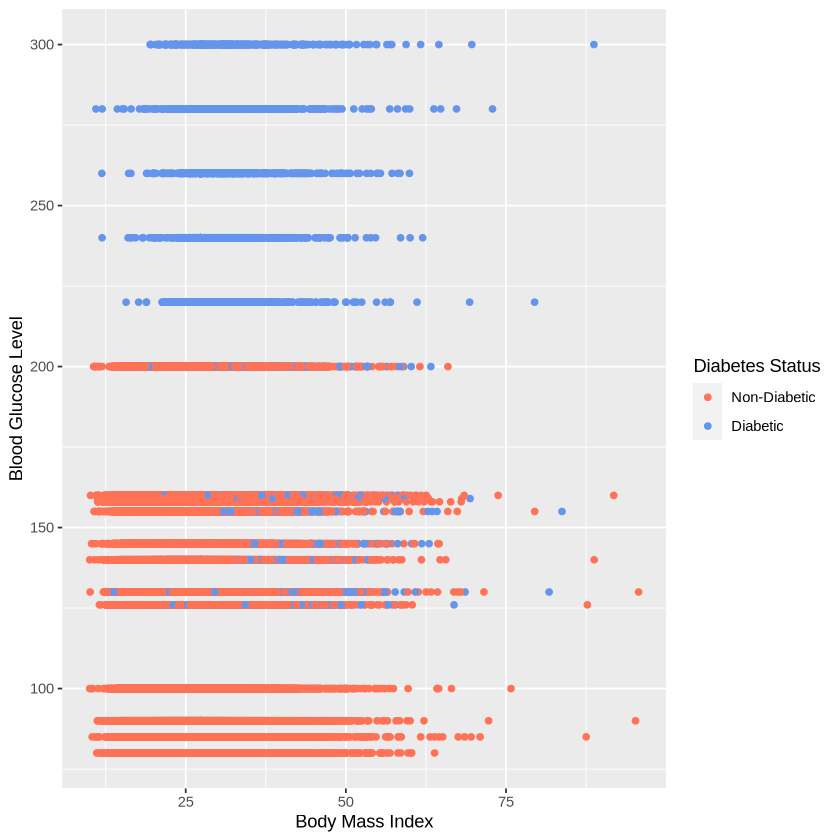

In [8]:
# Training data graph

diabetes_graph <- diabetes_train |>  
    ggplot(aes(x= bmi, 
               y= blood_glucose_level, 
               colour = diabetes)) +
        geom_point() +
        labs(x = "Body Mass Index",
             y = "Blood Glucose Level ()",
            colour = "Diabetes Status") +
            scale_colour_manual(values = c("coral1", "cornflowerblue"),
            labels = c("Non-Diabetic", "Diabetic"))

diabetes_graph